# Intro to Networks
The study of networks investigates the relationship between discrete objects using [graphs](https://en.wikipedia.org/wiki/Graph_(discrete_mathematics))

![network_diagram](https://upload.wikimedia.org/wikipedia/commons/2/2f/Small_Network.png)

Graphs are a mathematical structure which represent a set of objects (called nodes or vertices) as well as their symmetric or asymmetric relationships (called links or edges).

They can be used to represent both physical systems (roads, pipelines, electrical grid) and abstract systems (social, collaboration, genetics).

For this course, we'll be using the python `networkx` package, which provides many useful classes and functions for representing and doing computations with networks. 

In addition, we'll be using the `osmnx` package, which will download openstreetmap road networks as `networkx` objects. There are a ton of useful examples in the [examples repo](https://github.com/gboeing/osmnx-examples).

This lecture is based off of the [osmnx-examples](https://github.com/gboeing/osmnx-examples) code and the [Automating GIS Processes](https://automating-gis-processes.github.io/2018/notebooks/L6/retrieve_osm_data.html) course.

In [214]:
import networkx as nx # need networkx >= 2.5
import osmnx as ox
import contextily as ctx
from matplotlib import pyplot as plt
import matplotlib.colors as colors #for colormap
from shapely.geometry import Polygon
import folium
import numpy as np
import matplotlib.patches as mpatches
import geopandas as gpd
import pandas as pd
from shapely.ops import nearest_points

In [3]:
# Specify the name that is used to seach for the data
place_name = "Cambridge, MA, USA"

# Fetch OSM street network from the location
# this will take a while because there's a lot of streets
graph = ox.graph_from_place(place_name)

In [52]:
# metadata about the graph object
graph.graph

{'created_date': '2024-07-18 15:18:13',
 'created_with': 'OSMnx 1.9.3',
 'crs': 'epsg:4326',
 'simplified': True}

In [53]:
# we can save the graph to a file so that we don't have to
# wait for it to download again next time
ox.io.save_graphml(graph, 'cambridge_osmnx.graphml')

In [54]:
# loading graph from a file
graph = ox.io.load_graphml('cambridge_osmnx.graphml')

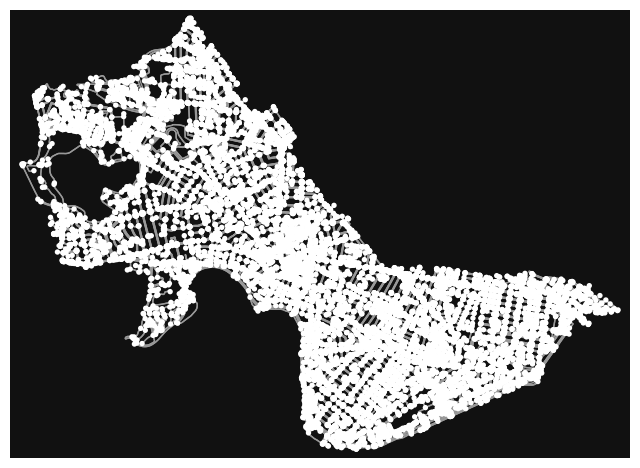

In [55]:
# Let's take a look at the graph
fig, ax = ox.plot_graph(graph)

In [56]:
# we can project the graph into epsg:3857 so that units are in meters
# using the .project_graph() function; 
# by default, osmnx graphs are created in WGS84, (epsg:4326)
graph_proj = ox.project_graph(graph, to_crs='epsg:3857')

In [57]:
# we can then convert the projected graph to a geodataframe
graph_nodes_gdf, graph_edges_gdf = ox.graph_to_gdfs(graph_proj)
graph_nodes_gdf.crs

<Projected CRS: EPSG:3857>
Name: WGS 84 / Pseudo-Mercator
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: World between 85.06°S and 85.06°N.
- bounds: (-180.0, -85.06, 180.0, 85.06)
Coordinate Operation:
- name: Popular Visualisation Pseudo-Mercator
- method: Popular Visualisation Pseudo Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [58]:
graph_nodes_gdf

,y,x,street_count,lon,lat,highway,ref,geometry
osmid,,,,,,,,
61175693,5.220801e+06,-7.917964e+06,3,-71.128276,42.398103,NaN,NaN,POINT (-7917963.521 5220801.149)
3895955644,5.220746e+06,-7.918006e+06,3,-71.128660,42.397735,NaN,NaN,POINT (-7918006.179 5220745.661)
61182955,5.218854e+06,-7.916612e+06,4,-71.116133,42.385184,traffic_signals,NaN,POINT (-7916611.679 5218853.87)
7893597542,5.218865e+06,-7.916612e+06,4,-71.116138,42.385255,crossing,NaN,POINT (-7916612.247 5218864.676)
7893597530,5.218844e+06,-7.916611e+06,4,-71.116130,42.385119,crossing,NaN,POINT (-7916611.345 5218844.104)
...,...,...,...,...,...,...,...,...
12036296267,5.214481e+06,-7.914626e+06,1,-71.098291,42.356163,NaN,NaN,POINT (-7914625.506 5214481.117)
12036318170,5.214452e+06,-7.914648e+06,1,-71.098489,42.355966,NaN,NaN,POINT (-7914647.547 5214451.531)
12036318175,5.214396e+06,-7.914746e+06,1,-71.099371,42.355596,NaN,NaN,POINT (-7914745.753 5214395.703)


In [59]:
graph_edges_gdf

osmid lanes  \
u           v           key                                               
61175693    3895955644  0                    [8615932, 386272429]     2   
3895955644  8515679674  0                               297244215   NaN   
            1092759643  0                               297244215   NaN   
            61175693    0                    [8615932, 386272429]     2   
61182955    7893597542  0                              1212708764     2   
...                                                           ...   ...   
12036318175 12036318171 0    [1299334778, 1299334779, 1299334780]   NaN   
12036491775 12036491776 0                              1299356038   NaN   
12040230482 12040230483 0                              1299828986   NaN   
            12040230484 0                              1042420666   NaN   
            12040230479 0                              1042420666   NaN   

                                            name              highway width  \
u           v           key                                                   
61175693    3895955644  0         Elmwood Street  [path, residential]  12.2   
3895955644  8515679674  0    Alewife Linear Park             cycleway   NaN   
            1092759643  0    Alewife Linear Park             cycleway   NaN   
            61175693    0         Elmwood Street  [path, residential]  12.2   
61182955    7893597542  0          Oxford Street             tertiary  15.2   
...                                          ...                  ...   ...   
12036318175 12036318171 0                    NaN     [steps, footway]   NaN   
12036491775 12036491776 0                    NaN              service   NaN   
12040230482 12040230483 0                    NaN              footway   NaN   
            12040230484 0                    NaN              footway   NaN   
            12040230479 0                    NaN              footway   NaN   

                             oneway reversed  length  \
u           v           key                            
61175693    3895955644  0     False     True  51.634   
3895955644  8515679674  0     False     True  62.071   
            1092759643  0     False    False  52.446   
            61175693    0     False    False  51.634   
61182955    7893597542  0     False    False   7.984   
...                             ...      ...     ...   
12036318175 12036318171 0     False     True  48.050   
12036491775 12036491776 0     False     True  53.915   
12040230482 12040230483 0     False     True   2.248   
            12040230484 0     False    False  31.113   
            12040230479 0     False     True  18.005   

                                                                      geometry  \
u           v           key                                                      
61175693    3895955644  0    LINESTRING (-7917963.521 5220801.149, -7917972...   
3895955644  8515679674  0    LINESTRING (-7918006.179 5220745.661, -7917922...   
            1092759643  0    LINESTRING (-7918006.179 5220745.661, -7918045...   
            61175693    0    LINESTRING (-7918006.179 5220745.661, -7918002...   
61182955    7893597542  0    LINESTRING (-7916611.679 5218853.87, -7916612....   
...                                                                        ...   
12036318175 12036318171 0    LINESTRING (-7914745.753 5214395.703, -7914776...   
12036491775 12036491776 0    LINESTRING (-7918566.583 5216693.767, -7918586...   
12040230482 12040230483 0    LINESTRING (-7912179.817 5216837.122, -7912177...   
            12040230484 0    LINESTRING (-7912179.817 5216837.122, -7912179...   
            12040230479 0    LINESTRING (-7912179.817 5216837.122, -7912181...   

                            maxspeed service  ref access bridge junction  \
u           v           key                                                
61175693    3895955644  0        NaN     NaN  NaN    NaN    NaN      NaN   
3895955644  8515679674  0       

In [60]:
# we can also get a gdf for the footprint of the place
place_footprint = ox.geocode_to_gdf(place_name)
graph_area = place_footprint.to_crs('epsg:3857')
graph_area

,geometry,bbox_north,bbox_south,bbox_east,bbox_west,place_id,osm_type,osm_id,lat,lon,class,type,place_rank,importance,addresstype,name,display_name
0,"POLYGON ((-7921539.37 5219058.583, -7921287.91...",42.404259,42.352402,-71.063984,-71.160399,17925017,relation,1933745,42.365635,-71.104002,boundary,administrative,16,0.614277,city,Cambridge,"Cambridge, Middlesex County, Massachusetts, Un..."


<Axes: >

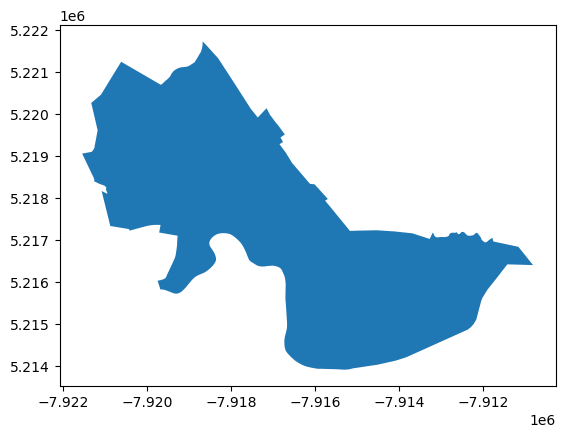

In [61]:
graph_area.plot()

## Exercises
What is the total area of cambridge in sq meters?

In [62]:
graph_area['geometry'].area

0    3.373285e+07
dtype: float64

How many street segments in Cambridge are longer than 100 meters?

In [63]:
x=list(graph_edges_gdf.loc[graph_edges_gdf['geometry'].length > 100]['length'])
sum(x)

777673.5759999991

In [64]:
sum(graph_edges_gdf[graph_edges_gdf['length'] > 100]['length'])

539246.0319999983

## Road network statistics

In [65]:
# we can get basic stats about the network:
ox.stats.basic_stats(graph_proj)

{'n': 16937,
 'm': 50148,
 'k_avg': 5.921709865973903,
 'edge_length_total': 1644783.0119999878,
 'edge_length_avg': 32.79857645369681,
 'streets_per_node_avg': 3.2491586467497195,
 'streets_per_node_counts': {0: 0,
  1: 1230,
  2: 41,
  3: 9079,
  4: 6476,
  5: 93,
  6: 15,
  7: 1,
  8: 2},
 'streets_per_node_proportions': {0: 0.0,
  1: 0.07262207002420736,
  2: 0.0024207356674735784,
  3: 0.5360453445120151,
  4: 0.3823581507941194,
  5: 0.005490937001830312,
  6: 0.0008856350002952116,
  7: 5.904233335301411e-05,
  8: 0.00011808466670602822},
 'intersection_count': 15707,
 'street_length_total': 903816.8579999988,
 'street_segment_count': 27360,
 'street_length_avg': 33.03424188596487,
 'circuity_avg': 0.7711381724878306,
 'self_loop_proportion': 0.001644736842105263}

Circuity is the ratio of network distance (distance traveled along roads) to euclidean distance (straight line). Higher circuity means greater inefficiency in traveling along the roads.

Check the [documentation](https://osmnx.readthedocs.io/en/stable/osmnx.html#module-osmnx.stats) for more info about each statistic

In [66]:
# if you pass in the area, you can get density info
area_cambridge_sqm = graph_area['geometry'].area
ox.basic_stats(graph_proj, area=area_cambridge_sqm)

{'n': 16937,
 'm': 50148,
 'k_avg': 5.921709865973903,
 'edge_length_total': 1644783.0119999878,
 'edge_length_avg': 32.79857645369681,
 'streets_per_node_avg': 3.2491586467497195,
 'streets_per_node_counts': {0: 0,
  1: 1230,
  2: 41,
  3: 9079,
  4: 6476,
  5: 93,
  6: 15,
  7: 1,
  8: 2},
 'streets_per_node_proportions': {0: 0.0,
  1: 0.07262207002420736,
  2: 0.0024207356674735784,
  3: 0.5360453445120151,
  4: 0.3823581507941194,
  5: 0.005490937001830312,
  6: 0.0008856350002952116,
  7: 5.904233335301411e-05,
  8: 0.00011808466670602822},
 'intersection_count': 15707,
 'street_length_total': 903816.8579999988,
 'street_segment_count': 27360,
 'street_length_avg': 33.03424188596487,
 'circuity_avg': 0.7711381724878306,
 'self_loop_proportion': 0.001644736842105263,
 'node_density_km': 0    502.092163
 dtype: float64,
 'intersection_density_km': 0    465.629191
 dtype: float64,
 'edge_density_km': 0    48759.08725
 dtype: float64,
 'street_density_km': 0    26793.373178
 dtype: fl

## Getting data other ways
In the above example, we used the name of a place to get the data that we wanted.

However, there are other ways to specify locations which may be more convenient.

For example, you can get [graphs from address](https://osmnx.readthedocs.io/en/stable/osmnx.html?highlight=poly#osmnx.core.graph_from_address), [bounding box](https://osmnx.readthedocs.io/en/stable/osmnx.html?highlight=poly#osmnx.core.graph_from_bbox), [points](https://osmnx.readthedocs.io/en/stable/osmnx.html?highlight=poly#osmnx.core.graph_from_bbox), or [shapely polygon object](https://osmnx.readthedocs.io/en/stable/osmnx.html?highlight=poly#osmnx.core.graph_from_polygon)

The types of networks you can get are:

-    `drive` - get drivable public streets (but not service roads)
-    `drive_service` - get drivable streets, including service roads
-    `walk` - get all streets and paths that pedestrians can use (this network type ignores one-way directionality)
-    `bike` - get all streets and paths that cyclists can use
-    `all` - download all non-private OSM streets and paths
-    `all_private` - download all OSM streets and paths, including private-access ones



In [67]:
# Coordinates of the MIT main campus in Decimal Degrees
coordinates = [(-71.092562, 42.357602), (-71.080155, 42.361553),
               (-71.089817, 42.362584), (-71.094688, 42.360198)]

# Create a Shapely polygon from the coordinate-tuple list
poly = Polygon(coordinates)

# convert to meters from latlong by projecting to epsg:3857
poly_m, poly_crs_m = ox.projection.project_geometry(poly, to_crs='epsg:3857')

# put a buffer of 1 mile (1609.34 m) to get everything w/in 1 mile
poly_with_buffer_m = poly_m.buffer(1609.34)

# convert back to lat-long
poly_with_buffer_ll, poly_crs_ll = ox.projection.project_geometry(poly_with_buffer_m, 
                                                        crs=poly_crs_m, 
                                                        to_crs='epsg:4326', 
                                                        to_latlong=True)

'''
# get all walkable roads within poly
walkable_roads_near_mit = ox.graph_from_polygon(poly_with_buffer_ll, 
                                       network_type='walk',
                                       clean_periphery=True)
'''
# Get all walkable roads within poly
walkable_roads_near_mit = ox.graph_from_polygon(
    poly_with_buffer_ll, 
    network_type='walk'
)


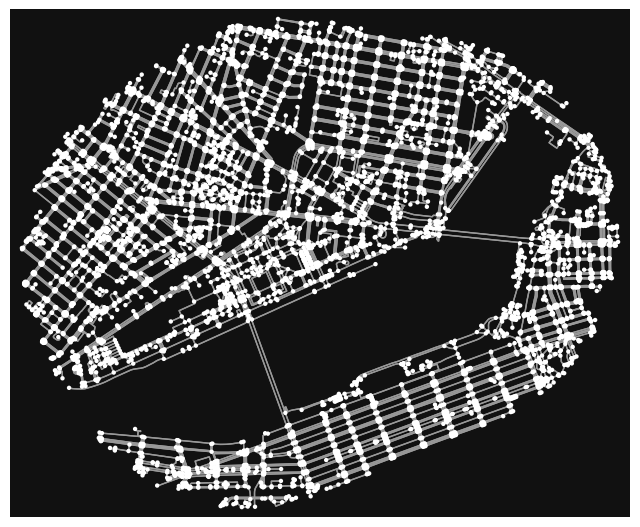

In [68]:
# let's plot it
fig, ax = ox.plot_graph(walkable_roads_near_mit, figsize=(8,10), node_size=10)

In [69]:
# example of a road
all_edges_list = list(walkable_roads_near_mit.edges) # put the id for each edge in a list
print(all_edges_list[0]) # id of first edge
print(walkable_roads_near_mit.edges[all_edges_list[0]]) # get details for first edge

(61283218, 7890342967, 0)
{'osmid': 1288824558, 'oneway': False, 'lanes': '2', 'name': 'Vassar Street', 'highway': 'tertiary', 'width': '17.1', 'reversed': True, 'length': 13.002}


In [70]:
# get attribute for all edges
walkable_roads_near_mit.edges(data='name')

OutMultiEdgeDataView([(61283218, 7890342967, 'Vassar Street'), (61283218, 7890342979, 'Amherst Alley'), (61283218, 5492841607, 'Vassar Street'), (61283269, 7866981406, 'Massachusetts Avenue'), (61283269, 7866981409, 'Massachusetts Avenue'), (61283269, 5737576890, 'Vassar Street'), (61283269, 7866981408, 'Vassar Street'), (61283293, 2694721017, 'Endicott Street'), (61283311, 7579360337, 'Endicott Street'), (61283311, 7071581206, 'Amherst Alley'), (61283311, 9692752987, 'Amherst Alley'), (61283350, 5872296719, 'Main Street'), (61283350, 5872296715, 'Main Street'), (61283350, 7866981387, 'Albany Street'), (61283361, 1053425134, 'Ames Street'), (61283361, 436587028, 'Ames Street'), (61283361, 7899628462, None), (61283361, 1753191577, None), (61283366, 7896253549, 'Technology Square'), (61283366, 5872296719, 'Main Street'), (61283366, 8519179718, 'Main Street'), (61283373, 8602936356, 'Hayward Street'), (61283373, 8646774735, 'Hayward Street'), (61283373, 9272850530, 'Main Street'), (612833

In [71]:
# example of a node (intersection)
all_nodes_list = list(walkable_roads_near_mit.nodes)
print(all_nodes_list[0]) # id of first node
print(walkable_roads_near_mit.nodes[all_nodes_list[0]]) # details for first node

61283218
{'y': 42.3559928, 'x': -71.1033176, 'street_count': 3}


In [72]:
# get attribute for all nodes
walkable_roads_near_mit.nodes(data='street_count')

NodeDataView({61283218: 3, 61283269: 4, 61283293: 1, 61283311: 3, 61283350: 3, 61283361: 4, 61283366: 3, 61283373: 4, 61283385: 3, 61317281: 1, 61317284: 1, 61317286: 3, 61317287: 3, 61317292: 3, 61317293: 3, 61317302: 3, 61317337: 3, 61317338: 3, 61317355: 3, 61317360: 3, 61317365: 3, 61317367: 4, 61317381: 3, 61317382: 3, 61317383: 3, 61317386: 3, 61317414: 1, 61317415: 1, 61317416: 3, 61317420: 5, 61317423: 5, 61317425: 3, 61317454: 3, 61317471: 1, 61317476: 3, 61317478: 3, 61317499: 3, 61317501: 3, 61317503: 3, 61317513: 1, 61317523: 3, 61317588: 4, 61317593: 1, 61317596: 3, 61317645: 1, 61317661: 3, 61317663: 3, 61317667: 4, 61317741: 3, 61317743: 3, 61318059: 4, 61318060: 4, 61318066: 1, 61318074: 1, 61318140: 3, 61318175: 3, 61318434: 4, 61318436: 4, 61318438: 3, 61318454: 3, 61318520: 4, 61318521: 3, 61318534: 4, 61318572: 4, 61318574: 3, 61318575: 3, 61318581: 3, 61318582: 4, 61318586: 3, 61318588: 3, 61318589: 4, 61318592: 3, 61318595: 3, 61318626: 3, 61318627: 3, 61320984: 4

## Exercise

How many walkable roads near MIT are longer than 100 meters?

In [73]:
lengths = list(walkable_roads_near_mit.edges(data='length'))

In [74]:
x = [sum(list(length)) > 100 for length in lengths]
x

[True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,

In [75]:
sum1 = 0
for edge in all_edges_list:
    length = walkable_roads_near_mit.edges[edge]['length']
    if length > 100:
        sum1 += 1

sum1

1348

## Routing
We can get the node closest to a point using the `ox.distance.nearest_node` function.

{7617297159: {0: {'osmid': 825494555, 'highway': 'footway', 'oneway': False, 'reversed': True, 'length': 5.059}}, 7617294178: {0: {'osmid': 825494554, 'highway': 'footway', 'oneway': False, 'reversed': False, 'length': 25.842, 'geometry': <LINESTRING (-71.069 42.357, -71.069 42.357, -71.07 42.357)>}}, 7617297164: {0: {'osmid': 842963302, 'highway': 'footway', 'oneway': False, 'reversed': False, 'length': 74.283, 'geometry': <LINESTRING (-71.069 42.357, -71.069 42.358, -71.07 42.358)>}}}


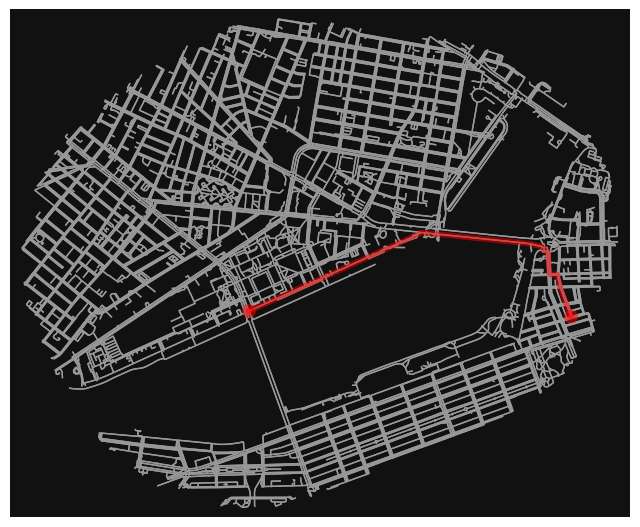

length of shortest walkable path from node 5737576908 to 7617297162 is 2373.57m


In [76]:
orig_node = ox.distance.nearest_nodes(walkable_roads_near_mit, -71.092562, 42.357602)

# let's calculate the route to a random destination node
rand_node = np.random.choice(walkable_roads_near_mit.nodes)
print(walkable_roads_near_mit[rand_node])

'''
route = ox.distance.shortest_path(walkable_roads_near_mit, 
                         orig_node, rand_node, 
                         weight='length')
'''
route = ox.routing.shortest_path(walkable_roads_near_mit, 
                         orig_node, rand_node, 
                         weight='length')

fig, ax = ox.plot_graph_route(walkable_roads_near_mit, route, node_size=0)
shortest_path_length = nx.shortest_path_length(walkable_roads_near_mit, orig_node, 
                              rand_node, weight='length')
print(f'length of shortest walkable path from node {orig_node} to {rand_node} is {shortest_path_length:.2f}m') # the {:.2f} syntax means round off to 2 digits after decimal pt

The `shortest_path` function in networkx uses [Dijkstra's algorithm](https://en.wikipedia.org/wiki/Dijkstra%27s_algorithm) to efficiently calculate the shortest path between two nodes. The networkx library also provides many other useful functions on graphs; for instance, the [Floyd-Warshall algorithm](https://en.wikipedia.org/wiki/Floyd%E2%80%93Warshall_algorithm), which efficiently computes the shortest paths between all pairs of nodes, and the [A* (A-star) algorithm](https://en.wikipedia.org/wiki/A*_search_algorithm), which is similar to Dijkstra's algorithm, except it runs faster by taking advantage of a distance "approximation" that can be calculated between two nodes without knowing the shortest path outright. Check out these links if you want to learn more about these algorithms, and check out the [networkx documentation](https://networkx.github.io/documentation/networkx-2.4/index.html) if you want to learn more about all the methods networkx provides.

## Building outlines
We can get the footprint of objects such as buildings as geodataframes with `osmnx`. Here we'll get the building footprints near MIT.

In [77]:
'''
# we can get the footprints of objects within this poly
building_footprints = ox.geometries.geometries_from_polygon(poly_with_buffer_ll, tags={'building':True})
'''
# we can get the footprints of objects within this poly
building_footprints = ox.features.features_from_polygon(poly_with_buffer_ll, tags={'building':True})


You can perform any query using OSM tags: https://wiki.openstreetmap.org/wiki/Map_features

Note that if you include multiple tags, it gets the **union** of the results, not the intersection

In [78]:
'''
road_footprints = ox.geometries.geometries_from_polygon(poly_with_buffer_ll, tags={'highway':True}) # get roads with geometry
# note that most roads do not have footprint information
'''
road_footprints = ox.features.features_from_polygon(poly_with_buffer_ll, tags={'highway':True}) # get roads with geometry
# note that most roads do not have footprint information

In [79]:
# project into UTM for info in meters
building_footprints_proj = ox.projection.project_gdf(building_footprints)
road_footprints_proj = ox.projection.project_gdf(road_footprints)
building_footprints_proj

description level operator railway wheelchair  \
element_type osmid                                                     
node         367777182         NaN   NaN      NaN     NaN        NaN   
             367777193         NaN   NaN      NaN     NaN        NaN   
             367777196         NaN   NaN      NaN     NaN        NaN   
             367777226         NaN   NaN      NaN     NaN        NaN   
             367777292         NaN   NaN      NaN     NaN        NaN   
...                            ...   ...      ...     ...        ...   
relation     16848651          NaN   NaN      NaN     NaN        NaN   
             17409127          NaN   NaN      NaN     NaN        NaN   
             17575546          NaN   NaN      NaN     NaN        NaN   
             17705207          NaN   NaN      NaN     NaN        NaN   
             17804937          NaN   NaN      NaN     NaN        NaN   

                                                                 geometry  \
element_type osmid                                                          
node         367777182                     POINT (327563.105 4691913.104)   
             367777193                     POINT (326878.992 4690851.306)   
             367777196                     POINT (327725.747 4692003.931)   
             367777226                     POINT (329688.089 4691892.609)   
             367777292                     POINT (327397.718 4690775.222)   
...                                                                   ...   
relation     16848651   POLYGON ((327283.553 4692160.017, 327326.644 4...   
             17409127   POLYGON ((327180.012 4691927.952, 327183.457 4...   
             17575546   POLYGON ((327987.438 4690513.203, 327983.717 4...   
             17705207   POLYGON ((329130.431 4692748.495, 329167.555 4...   
             17804937   POLYGON ((327777.158 4692106.398, 327778.165 4...   

                       height access door lockable  ... bicycle_parking area  \
element_type osmid                                  ...                        
node         367777182    NaN    NaN  NaN      NaN  ...             NaN  NaN   
             367777193    NaN    NaN  NaN      NaN  ...             NaN  NaN   
             367777196    NaN    NaN  NaN      NaN  ...             NaN  NaN   
             367777226    NaN    NaN  NaN      NaN  ...             NaN  NaN   
             367777292    NaN    NaN  NaN      NaN  ...             NaN  NaN   
...                       ...    ...  ...      ...  ...             ...  ...   
relation     16848651     NaN    NaN  NaN      NaN  ...             NaN  NaN   
             17409127    20.3    NaN  NaN      NaN  ...             NaN  NaN   
             17575546     NaN    NaN  NaN      NaN  ...             NaN  NaN   
             17705207     NaN    NaN  NaN      NaN  ...             NaN  NaN   
             17804937    48.4    NaN  NaN      NaN  ...             NaN  NaN   

                       abbr_name content opening_date name:signed reservation  \
element_type osmid                                                              
node         367777182       NaN     NaN          NaN         NaN         NaN   
             367777193       NaN     NaN          NaN         NaN         NaN   
             367777196       NaN     NaN          NaN         NaN         NaN   
             367777226       NaN     NaN          NaN         NaN         NaN   
             367777292       NaN     NaN          NaN         NaN         NaN   
...                          ...     ...          ...         ...         ...   
relation     16848651        NaN     NaN          NaN         NaN         NaN   
             17409127        NaN     NaN          NaN         NaN         NaN   
             17575546        NaN     NaN          NaN         NaN         NaN   
             17705207        NaN     NaN          NaN         NaN         NaN   
             17804937        NaN     NaN          NaN         NaN      

In [80]:
# column names
building_footprints_proj.columns.values

array(['description', 'level', 'operator', 'railway', 'wheelchair',
       'geometry', 'height', 'access', 'door', 'lockable', 'man_made',
       'addr:city', 'addr:state', 'building', 'ele', 'gnis:feature_id',
       'name', 'source', 'addr:housenumber', 'addr:postcode',
       'addr:street', 'tourism', 'bicycle', 'amenity', 'maxheight',
       'parking', 'colour', 'toilets', 'toilets:air_conditioning',
       'toilets:disposal', 'toilets:fee', 'toilets:female',
       'toilets:handwashing:soap', 'toilets:hot_water', 'toilets:male',
       'toilets:menstrual_products', 'toilets:paper_supplied',
       'toilets:position', 'toilets:unisex', 'toilets:wheelchair',
       'image', 'covered', 'surface', 'indoor', 'seasonal', 'material',
       'motor_vehicle', 'generator:output:electricity',
       'generator:source', 'location', 'operator:wikidata',
       'operator:wikipedia', 'power', 'ref', 'substation', 'transformer',
       'voltage', 'country', 'lit', 'supervised', 'emergency', 'capa

In [81]:
# drop rows where there's no shape info
building_footprints_proj = building_footprints_proj.dropna(subset=['geometry'])
road_footprints = road_footprints.dropna(subset=['geometry'])

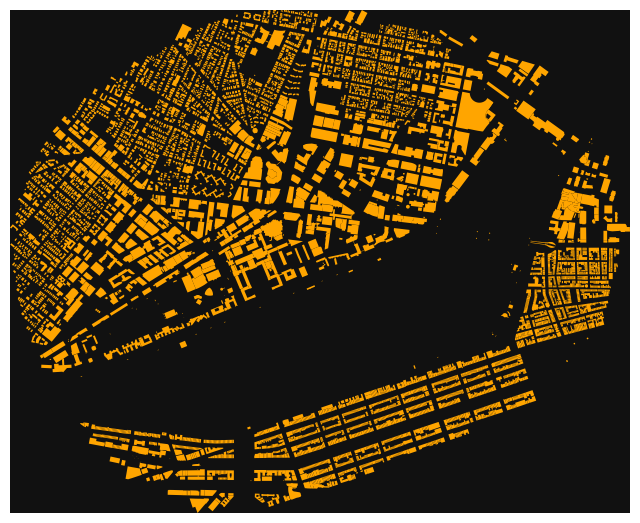

In [82]:
fig, ax = ox.plot_footprints(building_footprints_proj)

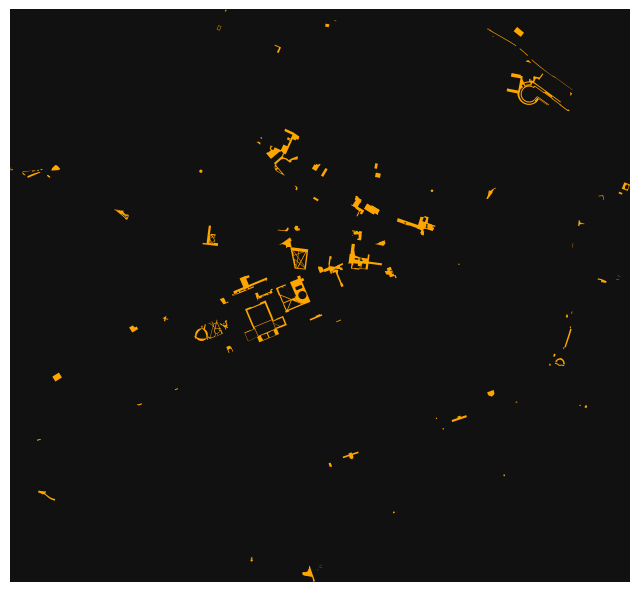

In [83]:
# plot roads with footprints
fig, ax = ox.plot_footprints(road_footprints_proj) # note that this is only a small subset of all roads

In [84]:
# save the geodataframe to a file to persist
# can choose to write only a subset of columns if you want
building_footprints_proj[['description', 'operator', 'railway', 'geometry', 'attribution',
       'source', 'addr:city', 'addr:housenumber', 'addr:postcode',
       'addr:state', 'addr:street', 'amenity']].to_file('buildings_around_mit.geojson', driver='GeoJSON')


# Exercises
Plot the walkable roads and buildings in the area near MIT in the same figure. The `osmnx` plotting features use matplotlib on the backend. Check [the documentation](https://osmnx.readthedocs.io/en/stable/osmnx.html#osmnx.plot.plot_graph) for more formatting options for plotting

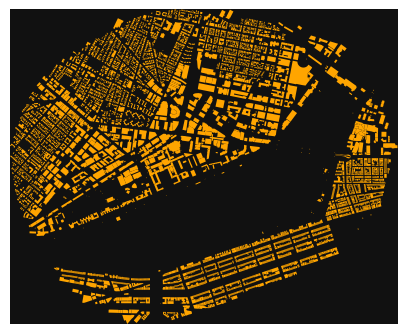

(<Figure size 500x500 with 1 Axes>, <Axes: >)

In [109]:
fig, ax1 = ox.plot_footprints(building_footprints_proj, figsize=(5,5))
ox.plot_footprints(road_footprints_proj, ax=ax1)
#only shows building_footprints, need to concat the dataframes first, then pass it in.

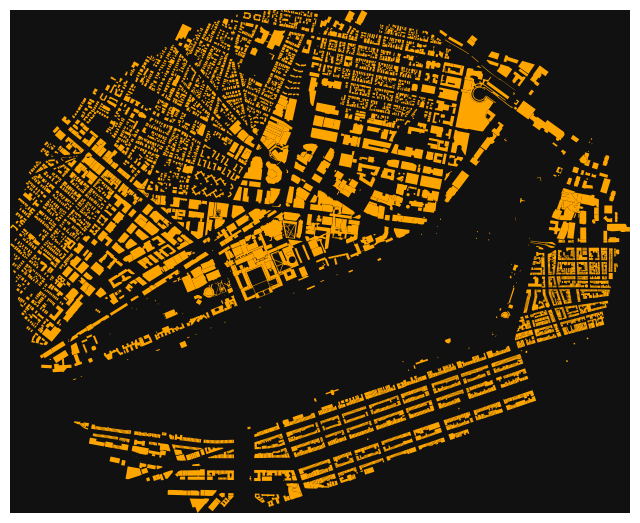

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [112]:
import pandas as pd
combined = pd.concat((building_footprints_proj, road_footprints_proj), join='inner')
ox.plot_footprints(combined)

Now, go back to one of the previous exercises and plot all the nodes on the periphery of Cambridge and the roads in Cambridge in the same figure.

## Interactive graph with folium
Folium is a library which creates interactive web maps. This can be used to visualize and explore the data. However, it is slower to load and cannot scale to as large networks as the standard matplotlib plotting

In [88]:
'''
folium_graph = ox.plot_graph_folium(walkable_roads_near_mit)
folium_graph
'''
import osmnx as ox
# pip install folium matplotlib mapclassify
# Convert the walkable roads graph to GeoDataFrames
graph_nodes_gdf, graph_edges_gdf = ox.graph_to_gdfs(walkable_roads_near_mit)

# Use the explore method to create an interactive web map
map_edges = graph_edges_gdf.explore()

# Optionally, you can save the map to an HTML file to view it in a browser
map_edges.save('walkable_roads_near_mit.html')

# To display the map in a Jupyter notebook
map_edges


In [89]:
'''
ox.plot_route_folium(walkable_roads_near_mit, route, route_map = folium_graph, color='#ff0000')
'''
import geopandas as gpd
from shapely.geometry import LineString


# Extract the route geometry
route_nodes_gdf = graph_nodes_gdf.loc[route]
route_line = LineString(route_nodes_gdf.geometry.tolist())

# Create a GeoDataFrame for the route
route_gdf = gpd.GeoDataFrame(geometry=[route_line], crs=graph_edges_gdf.crs)

# Add the route to the map
map_edges = route_gdf.explore(m=map_edges, color='#ff0000', tooltip=False)

# To display the map in a Jupyter notebook
map_edges


## Get places of interest
OSM can also give places of interest, like restaurants, pharmacies, hospitals, and toilets. The full list is available [here](https://wiki.openstreetmap.org/wiki/Key:amenity).

Let's look at the POIs near MIT.

In [90]:
'''
fast_food = ox.geometries.geometries_from_polygon(poly_with_buffer_ll, tags={'amenity': 'fast_food'})
'''
fast_food = ox.features.features_from_polygon(poly_with_buffer_ll, tags={'amenity': 'fast_food'})
fast_food

addr:housenumber addr:postcode           addr:street  \
element_type osmid                                                              
node         566889950                263         02139      Brookline Street   
             566890089                272         02139      Brookline Street   
             1735987384               280           NaN      Cambridge Street   
             2134089521               598         02139  Massachusetts Avenue   
             2350393263               530         02215   Commonwealth Avenue   
             2367929358               540         02215   Commonwealth Avenue   
             2428711851               NaN           NaN                   NaN   
             2428711853               NaN           NaN                   NaN   
             2430573649               NaN           NaN                   NaN   
             2446018087               NaN           NaN                   NaN   
             2501165514               NaN           NaN                   NaN   
             2560514681               245           NaN  Massachusetts Avenue   
             2686928559               255         02142           Main Street   
             2700809502               242         02114      Cambridge Street   
             2707976346               736         02139  Massachusetts Avenue   
             2707976349               744         02139  Massachusetts Avenue   
             2708166079               277         02114      Cambridge Street   
             3773606173                26         02139                   NaN   
             4354050789                42           NaN        Charles Street   
             4360543289                 4         02139                   NaN   
             4406184596               300         02114      Cambridge Street   
             4406184597               296         02114      Cambridge Street   
             4406195907               161         02114        Charles Street   
             4722509102               181         02139  Massachusetts Avenue   
             5019071925               NaN           NaN                   NaN   
             5122876709               181         02139  Massachusetts Avenue   
             5627766951               292           NaN  Massachusetts Avenue   
             5633740689               NaN           NaN                   NaN   
             5633753513               NaN           NaN                   NaN   
             5811134127               225         02116        Newbury Street   
             6117409528               301           NaN          Third Street   
             7501883775               234         02116        Newbury Street   
             7625672550              324a         02115        Newbury Street   
             7735023387               255         02116        Newbury Street   
             7785682404               244         02116        Newbury Street   
             7911407804               NaN           NaN                   NaN   
             7924592200                 1         02142              Broadway   
             9701394228               NaN           NaN                   NaN   
             9749969793               625         02142   West Kendall Street   
             9925922688               NaN           NaN                   NaN   
             10760274783               23           NaN       Prospect Street   
             11543746984              201         02142   Galileo Galilei Way   
way          29938285                 463         02139  Massachusetts Avenue   

                            amenity  check_date              cuisine  \
element_type osmid                                                     
node         566889950    fast_food  2023-05-16                pizza   
             566890089    fast_food         NaN                greek   
             1735987384   fast_food         NaN                pizza   
             213408

In [91]:
walkable_nodes, walkable_edges = ox.graph_to_gdfs(walkable_roads_near_mit)

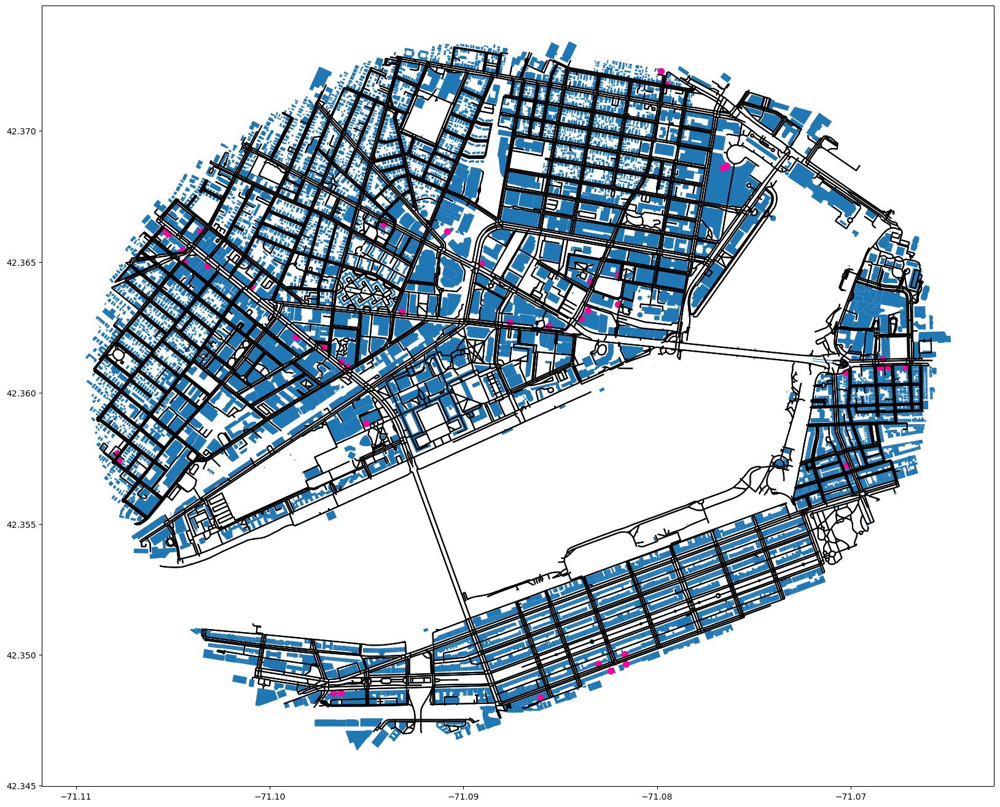

In [92]:
# plot roads, buildings, and fast_food
fig, ax = plt.subplots(1,1, figsize=[20,20])
building_footprints.plot(ax=ax)
walkable_edges.plot(ax=ax, color='black')
fast_food.plot(ax=ax, color='#FF0099', markersize=50)
plt.show()

In [167]:
graph_area

,geometry,bbox_north,bbox_south,bbox_east,bbox_west,place_id,osm_type,osm_id,lat,lon,class,type,place_rank,importance,addresstype,name,display_name
0,"POLYGON ((-7921539.37 5219058.583, -7921287.91...",42.404259,42.352402,-71.063984,-71.160399,17925017,relation,1933745,42.365635,-71.104002,boundary,administrative,16,0.614277,city,Cambridge,"Cambridge, Middlesex County, Massachusetts, Un..."


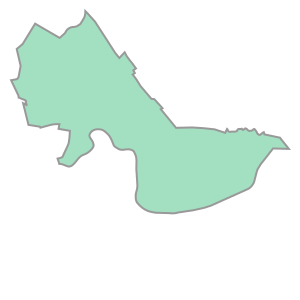

In [136]:
graph_area['geometry'][0]

In [163]:
cambridge_polygon = graph_area.to_crs('epsg:4326')['geometry'][0]
icecream_footprints = ox.features.features_from_polygon(cambridge_polygon, tags={'amenity':'ice_cream'}).dropna(subset=['geometry'])
icecream_footprints_proj = ox.projection.project_gdf(icecream_footprints)
icecream_footprints_proj['geometry']

element_type  osmid      
node          317333141      POINT (327119.952 4692276.378)
              480692709      POINT (325658.205 4693347.524)
              541316313       POINT (327068.95 4692282.527)
              1831393836     POINT (327231.489 4693382.664)
              1937035235     POINT (325569.515 4695133.011)
              5916924485     POINT (328878.044 4692510.877)
              6101491948     POINT (325496.968 4694500.335)
              6124473598     POINT (325501.048 4693311.842)
              7100285260      POINT (325445.885 4693533.62)
              7100285261      POINT (325414.85 4693264.236)
              11117788901    POINT (327897.486 4692714.744)
              12052439259    POINT (325891.171 4693157.011)
Name: geometry, dtype: geometry

In [164]:
icecream_footprints.columns

Index(['addr:housenumber', 'addr:street', 'amenity', 'check_date', 'cuisine',
       'name', 'opening_hours', 'toilets', 'toilets:access', 'website',
       'wheelchair', 'wikidata', 'geometry', 'addr:city', 'addr:postcode',
       'addr:state', 'branch', 'brand', 'brand:wikidata', 'delivery',
       'drive_through', 'outdoor_seating', 'phone', 'takeaway',
       'contact:email', 'check_date:opening_hours', 'opening_hours:signed',
       'contact:facebook', 'contact:instagram', 'contact:linkedin',
       'contact:phone', 'contact:twitter', 'facebook', 'start_date',
       'twitter'],
      dtype='object')

In [165]:
icecream_footprints = icecream_footprints[['name','addr:street','check_date:opening_hours','website','geometry']]

In [166]:
m = graph_area.explore()
m = icecream_footprints.explore(m=m, color='red')
m

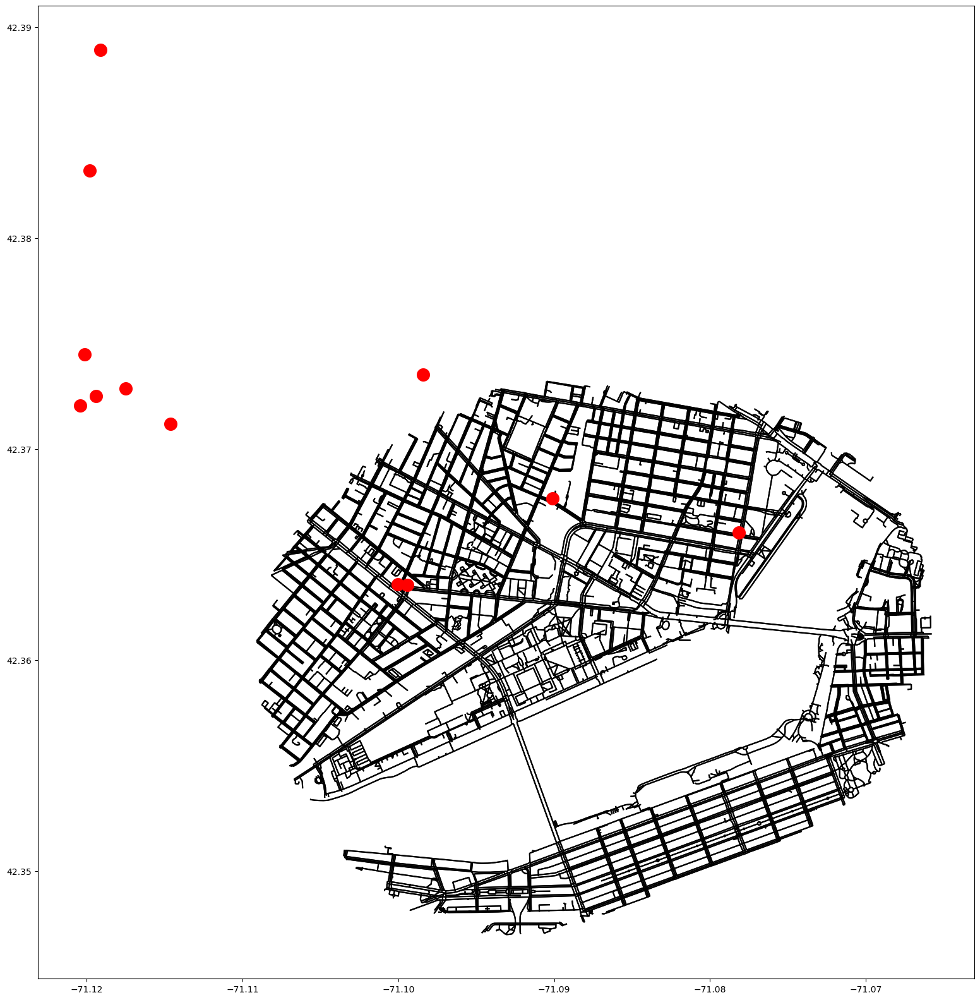

In [141]:
fig, ax = plt.subplots(1,1, figsize=[20,20])
icecream_footprints.plot(ax=ax, color='red', markersize=200,zorder=1)
walkable_edges.plot(ax=ax, color='black',zorder=0)
plt.show()

In [123]:
#get a list of the nearest node to each icecream place
icecream_nodes = []


for icecream_shop in icecream_footprints:
    print(icecream_shop)
    #nearest_node = osmnx.distance.nearest_nodes(walkable_edges, icecream_shop

['a', 'd', 'd', 'r', ':', 'h', 'o', 'u', 's', 'e', 'n', 'u', 'm', 'b', 'e', 'r']
['a', 'd', 'd', 'r', ':', 's', 't', 'r', 'e', 'e', 't']
['a', 'm', 'e', 'n', 'i', 't', 'y']
['c', 'h', 'e', 'c', 'k', '_', 'd', 'a', 't', 'e']
['c', 'u', 'i', 's', 'i', 'n', 'e']
['n', 'a', 'm', 'e']
['o', 'p', 'e', 'n', 'i', 'n', 'g', '_', 'h', 'o', 'u', 'r', 's']
['t', 'o', 'i', 'l', 'e', 't', 's']
['t', 'o', 'i', 'l', 'e', 't', 's', ':', 'a', 'c', 'c', 'e', 's', 's']
['w', 'e', 'b', 's', 'i', 't', 'e']
['w', 'h', 'e', 'e', 'l', 'c', 'h', 'a', 'i', 'r']
['w', 'i', 'k', 'i', 'd', 'a', 't', 'a']
['g', 'e', 'o', 'm', 'e', 't', 'r', 'y']
['a', 'd', 'd', 'r', ':', 'p', 'o', 's', 't', 'c', 'o', 'd', 'e']
['d', 'r', 'i', 'v', 'e', '_', 't', 'h', 'r', 'o', 'u', 'g', 'h']
['o', 'u', 't', 'd', 'o', 'o', 'r', '_', 's', 'e', 'a', 't', 'i', 'n', 'g']
['a', 'd', 'd', 'r', ':', 'c', 'i', 't', 'y']
['a', 'd', 'd', 'r', ':', 's', 't', 'a', 't', 'e']
['c', 'h', 'e', 'c', 'k', '_', 'd', 'a', 't', 'e', ':', 'o', 'p', 'e', '

# Exercise
In groups, pick a location, ask an interesting question, do an analysis to answer that question.


In [238]:
# Specify the name that is used to seach for the data
place_name = "New York City, New York, USA"

In [239]:
# Fetch OSM street network from the location
# this will take a while because there's a lot of streets
graph_nyc = ox.graph_from_place(place_name)

/opt/conda/lib/python3.11/site-packages/osmnx/graph.py:392: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  polygon = gdf_place["geometry"].unary_union


In [234]:
graph_manhattan=graph_nyc

In [235]:
graph_manhattan.graph

{'created_date': '2024-07-18 18:53:41',
 'created_with': 'OSMnx 1.9.3',
 'crs': 'epsg:4326',
 'simplified': True}

In [240]:
ox.io.save_graphml(graph_nyc, 'nyc_osmnx.graphml')

In [241]:
graph_nyc = ox.io.load_graphml('nyc_osmnx.graphml')

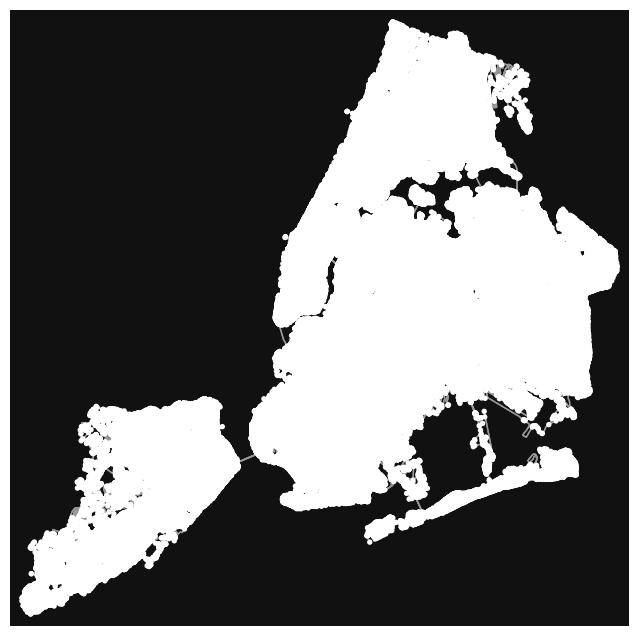

In [242]:
fig, ax = ox.plot_graph(graph_nyc)

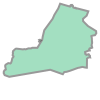

In [245]:
# we can also get a gdf for the footprint of the place
manhattan_footprint = ox.geocode_to_gdf(place_name)
manhattan_polygon = manhattan_footprint['geometry'][0]
manhattan_polygon

In [246]:
healthcare_footprints = ox.features.features_from_polygon(manhattan_polygon, tags={'amenity':'hospital'}).dropna(subset=['geometry'])
healthcare_footprints_proj = ox.projection.project_gdf(healthcare_footprints).dropna()
healthcare_footprints_proj['geometry']

GeoSeries([], Name: geometry, dtype: geometry)

In [247]:
(healthcare_footprints_proj.columns.to_list())

['geometry',
 'addr:city',
 'addr:housenumber',
 'addr:postcode',
 'addr:street',
 'amenity',
 'beds',
 'emergency',
 'gnis:feature_id',
 'healthcare',
 'name',
 'opening_hours',
 'operator',
 'phone',
 'website',
 'wikidata',
 'wikipedia',
 'addr:state',
 'healthcare:speciality',
 'access',
 'old_name',
 'short_name',
 'check_date',
 'operator:wikidata',
 'operator:wikipedia',
 'note',
 'entrance',
 'operator:type',
 'atm',
 'drive_through',
 'nycdoitt:bin',
 'internet_access',
 'email',
 'addr:floor',
 'source',
 'wheelchair',
 'nodes',
 'healthcare:for',
 'operator:short',
 'alt_name',
 'official_name',
 'start_date',
 'building',
 'urgent_care',
 'height',
 'addr:housename',
 'building:levels',
 'toilets',
 'loc_name',
 'building:colour',
 'building:material',
 'ways',
 'type']

In [248]:
healthcare_footprints = healthcare_footprints.iloc[:,0:17]

In [249]:
roads_near_manhattan = ox.graph_from_polygon(
    manhattan_polygon, 
    network_type='drive'
)
ox.io.save_graphml(roads_near_manhattan, 'manhattan_roads_osmnx.graphml')

In [250]:
roads_in_manhattan = roads_near_manhattan

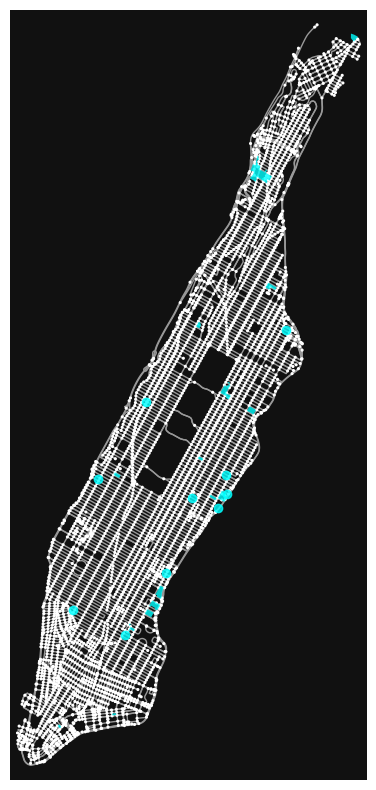

In [63]:
fig, ax = ox.plot_graph(roads_in_manhattan, figsize=(8,10), node_size=5, show=False, close=False)
healthcare_footprints.plot(ax=ax, color='cyan', alpha=0.8)

plt.show()

In [ ]:
#density of manhattan is 58.69 people per km^2
#population of manhattan is 1.646M people

In [67]:
area_manhattan_sqm = manhattan_footprint.to_crs('epsg:3857')['geometry'][0].area
stats = ox.basic_stats(graph_nyc, area=area_manhattan_sqm)

{'n': 48975,
 'm': 149527,
 'k_avg': 6.1062582950484945,
 'edge_length_total': 5376382.285999966,
 'edge_length_avg': 35.95592960468655,
 'streets_per_node_avg': 3.4408167432363452,
 'streets_per_node_counts': {0: 0,
  1: 3724,
  2: 62,
  3: 16399,
  4: 28498,
  5: 277,
  6: 13,
  7: 2},
 'streets_per_node_proportions': {0: 0.0,
  1: 0.0760387953037264,
  2: 0.0012659520163348648,
  3: 0.3348443083205717,
  4: 0.581888718734048,
  5: 0.005655946911689637,
  6: 0.00026544155181214903,
  7: 4.0837161817253704e-05},
 'intersection_count': 45251,
 'street_length_total': 3110369.561000002,
 'street_segment_count': 84226,
 'street_length_avg': 36.92885286016197,
 'circuity_avg': 1.0256233251886095,
 'self_loop_proportion': 0.0007479875572863487,
 'node_density_km': 511.04376393355784,
 'intersection_density_km': 472.18461177656815,
 'edge_density_km': 56101.41173625582,
 'street_density_km': 32456.048344620907}

In [68]:
len(healthcare_footprints)

29

In [244]:
healthcare_footprints.to_csv("manhattan_hospitals.csv")

In [69]:
people_per_hospital = 1646000/29
people_per_hospital

56758.620689655174

In [73]:
nx.get_node_attributes(graph_nyc,'population')

{}

In [ ]:
#both datasets used for hospital overcrowdedness here:
#https://www.nyc.gov/site/planning/data-maps/open-data/census-download-metadata.page
#https://www.kaggle.com/datasets/muonneutrino/new-york-city-census-data?select=nyc_census_tracts.csv

In [76]:
!unzip nyct2020_24b.zip -d nyc_census

Archive:  nyct2020_24b.zip
  inflating: nyc_census/nyct2020_24b/nyct2020.shp  
  inflating: nyc_census/nyct2020_24b/nyct2020.dbf  
  inflating: nyc_census/nyct2020_24b/nyct2020.shx  
  inflating: nyc_census/nyct2020_24b/nyct2020.prj  
  inflating: nyc_census/nyct2020_24b/nyct2020.shp.xml  


In [96]:
# path to shapefile
filepath = "nyc_census/nyct2020_24b/nyct2020.shp"

# Read file using gpd.read_file()
geo_census_data = gpd.read_file(filepath).sort_values(by='GEOID',ascending=True)

In [112]:
geo_census_data = geo_census_data[['GEOID','BoroName','Shape_Area','geometry']].dropna()
geo_census_data['GEOID'] = geo_census_data['GEOID'].astype(np.int64)
geo_census_data.head()

,GEOID,BoroName,Shape_Area,geometry
2313,36005000100,Bronx,1.816373e+07,"POLYGON ((1019454.697 225654.329, 1019451.101 ..."
154,36005000200,Bronx,4.877013e+06,"POLYGON ((1023972.528 232680.658, 1023970.431 ..."
2317,36005000400,Bronx,8.557953e+06,"POLYGON ((1026849.274 235548.774, 1026749.976 ..."
155,36005001600,Bronx,5.221330e+06,"POLYGON ((1024344.112 238946.021, 1024391.333 ..."
984,36005001901,Bronx,2.232574e+06,"POLYGON ((1005211.998 233365.999, 1005209.921 ..."


In [141]:
geo_census_data = geo_census_data.to_crs('epsg:4326')
geo_census_data.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [142]:
pop_census_data = pd.read_csv("nyc_census_tracts.csv").sort_values(by='CensusTract',ascending=True)
pop_census_data = pop_census_data[['CensusTract','Borough','TotalPop']].dropna()

pop_census_data.head()

,CensusTract,Borough,TotalPop
0,36005000100,Bronx,7703
1,36005000200,Bronx,5403
2,36005000400,Bronx,5915
3,36005001600,Bronx,5879
4,36005001900,Bronx,2591


In [233]:
census_data = pop_census_data.merge(geo_census_data, left_on='CensusTract',\
                                    right_on='GEOID', how='inner').drop(columns='GEOID')

#census_data = census_data.query("Borough == 'Manhattan'")
census_data.to_csv("pop_tract_census_data.csv")
census_data.head()

,CensusTract,Borough,TotalPop,BoroName,Shape_Area,geometry
0,36005000100,Bronx,7703,Bronx,1.816373e+07,"POLYGON ((-73.87287 40.78598, -73.87288 40.785..."
1,36005000200,Bronx,5403,Bronx,4.877013e+06,"POLYGON ((-73.85652 40.80524, -73.85652 40.805..."
2,36005000400,Bronx,5915,Bronx,8.557953e+06,"POLYGON ((-73.84611 40.8131, -73.84647 40.8123..."
3,36005001600,Bronx,5879,Bronx,5.221330e+06,"POLYGON ((-73.85514 40.82244, -73.85497 40.821..."
4,36005002300,Bronx,4774,Bronx,1.126745e+06,"POLYGON ((-73.92289 40.80911, -73.92324 40.808..."


In [251]:
print(len(census_data))

2034


In [198]:
sample_hospital = healthcare_footprints.iloc[0]
sample_hospital

geometry                                 POINT (-74.0008333 40.7377778)
addr:city                                                      New York
addr:housenumber                                                     30
addr:postcode                                                     10011
addr:street                                                  7th Avenue
amenity                                                        hospital
check_date                                                   2024-01-11
emergency                                                           yes
gnis:feature_id                                                 2082882
healthcare                                                     hospital
name                                     Lenox Health Greenwich Village
opening_hours                                                      24/7
operator                                               Northwell Health
operator:wikidata                                              Q

In [199]:
sample_hospital_point = sample_hospital['geometry']

In [200]:
for index, tract in census_data.iterrows():
    tract_polygon = tract['geometry']
    if tract_polygon.contains(sample_hospital_point):
        print(tract['TotalPop'])

5599


In [252]:
pop_list = []
area_list = []

for index, hospital in healthcare_footprints.iterrows():
    hospital_point = hospital['geometry']

    tract_found = False
    for index, tract in census_data.iterrows():
        tract_polygon = tract['geometry']
        if tract_polygon.contains(hospital_point):
            tract_found = True
            pop_list.append(tract['TotalPop'])
            area_list.append(tract['Shape_Area'] / (10**6)) #converting m^2 to km^2

    if tract_found == False:
        pop_list.append(None)
        area_list.append(None)

pop_list, area_list

([5654,
  740,
  1688,
  5654,
  1688,
  None,
  5599,
  None,
  3076,
  None,
  7456,
  None,
  8032,
  5654,
  3516,
  1658,
  2482,
  None,
  10402,
  3972,
  4028,
  2540,
  4017,
  2567,
  1894,
  2899,
  None,
  740,
  4759,
  None,
  9135,
  None,
  None,
  None,
  4536,
  4536,
  4536,
  654,
  5487,
  4074,
  7325,
  2434,
  2278,
  4693,
  2629,
  8113,
  12554,
  5099,
  6423,
  1933,
  1688,
  6563,
  2961,
  None,
  2609,
  2218,
  None,
  2178,
  6191,
  2961,
  None,
  4500,
  740,
  740,
  1660,
  1288,
  None,
  3516,
  7455,
  1256,
  1256,
  2816,
  6750,
  2749,
  4616,
  1363,
  1363,
  3216,
  3405,
  4365,
  293,
  5018,
  2502,
  None,
  7325,
  3076,
  6226,
  2217,
  None,
  4412,
  None,
  1958,
  None,
  1871,
  4348,
  3131,
  2852,
  4902,
  5842,
  6502,
  None,
  None,
  None,
  2380,
  5378,
  6690,
  None],
 [2.6733419176799997,
  12.1901462807,
  23.4665377637,
  2.6733419176799997,
  23.4665377637,
  None,
  1.9249958546700001,
  None,
  2.1175527854

In [202]:
#20 out of the 29 hospitals had a GEOID matching a tract in the census data. The others' populations and areas are marked as 'None'
#Area is in km^2 since crs specified to be web mercator, each area divided by 10^6

In [253]:
healthcare_footprints['tract_pop'] = pop_list
healthcare_footprints['tract_area'] = area_list
healthcare_footprints.head()

geometry     addr:city  \
element_type osmid                                                 
node         357571909  POINT (-73.87984 40.88009)         Bronx   
             357607640  POINT (-73.83883 40.84647)         Bronx   
             357607688  POINT (-73.93226 40.78653)  Wards Island   
             357611253   POINT (-73.8814 40.88036)         Bronx   
             357616245  POINT (-73.92791 40.78515)      New York   

                       addr:housenumber addr:postcode        addr:street  \
element_type osmid                                                         
node         357571909              111         10467  East 210th Street   
             357607640             1300         10461       Waters Place   
             357607688              600         10029  East 125th Street   
             357611253             3424         10467     Kossuth Avenue   
             357616245               13         10029   Hell Gate Circle   

                         amenity beds emergency gnis:feature_id healthcare  \
element_type osmid                                                           
node         357571909  hospital  726       yes          957548   hospital   
             357607640  hospital  NaN        no         1993274   hospital   
             357607688  hospital  NaN        no         1993311   hospital   
             357611253  hospital  NaN       yes         2072352   hospital   
             357616245  hospital  231        no         2076782   hospital   

                                                                     name  \
element_type osmid                                                          
node         357571909  Montefiore Medical Center West Campus Moses Di...   
             357607640       New York City Children's Center Bronx Campus   
             357607688                  Kirby Forensic Psychiatric Center   
             357611253                       North Central Bronx Hospital   
             357616245               George Rosenfeld Center for Recovery   

                       opening_hours                  operator  \
element_type osmid                                               
node         357571909          24/7  Montefiore Health System   
             357607640           NaN                       NaN   
             357607688           NaN                       NaN   
             357611253          24/7    NYC Health + Hospitals   
             357616245           NaN             Odyssey House   

                                  phone  \
element_type osmid                        
node         357571909  +1 718 920 4321   
             357607640  +1 718 239 3600   
             357607688  +1 646 672 5800   
             357611253  +1 718 519 5000   
             357616245  +1 212 426 6633   

                                                                  website  \
element_type osmid                                                          
node         357571909                    https://www.montefiore.org/west   
             357607640  https://www.omh.ny.gov/omhweb/facilities/nyccc...   
             357607688     https://www.omh.ny.gov/omhweb/facilities/krpc/   
             357611253  https://www.nychealthandhospitals.org/northcen...   
             357616245  https://odysseyhousenyc.org/george-rosenfeld-c...   

                         wikidata                     wikipedia  tract_pop  \
element_type osmid                                                           
node         357571909   Q6905066  en:Montefiore Medical Center     5654.0   
             357607640        NaN                           NaN      740.0   
             357607688  Q78638788                           NaN     1688.0   
             357611253  Q96396296                           NaN     5654.0   
             357616245        NaN                           NaN     1688.0   

                        tract_area  
element_type osmid                  
node         357571

In [254]:
healthcare_footprints['tract_density'] = healthcare_footprints['tract_pop'] / healthcare_footprints['tract_area']
healthcare_footprints.head()

geometry     addr:city  \
element_type osmid                                                 
node         357571909  POINT (-73.87984 40.88009)         Bronx   
             357607640  POINT (-73.83883 40.84647)         Bronx   
             357607688  POINT (-73.93226 40.78653)  Wards Island   
             357611253   POINT (-73.8814 40.88036)         Bronx   
             357616245  POINT (-73.92791 40.78515)      New York   

                       addr:housenumber addr:postcode        addr:street  \
element_type osmid                                                         
node         357571909              111         10467  East 210th Street   
             357607640             1300         10461       Waters Place   
             357607688              600         10029  East 125th Street   
             357611253             3424         10467     Kossuth Avenue   
             357616245               13         10029   Hell Gate Circle   

                         amenity beds emergency gnis:feature_id healthcare  \
element_type osmid                                                           
node         357571909  hospital  726       yes          957548   hospital   
             357607640  hospital  NaN        no         1993274   hospital   
             357607688  hospital  NaN        no         1993311   hospital   
             357611253  hospital  NaN       yes         2072352   hospital   
             357616245  hospital  231        no         2076782   hospital   

                                                                     name  \
element_type osmid                                                          
node         357571909  Montefiore Medical Center West Campus Moses Di...   
             357607640       New York City Children's Center Bronx Campus   
             357607688                  Kirby Forensic Psychiatric Center   
             357611253                       North Central Bronx Hospital   
             357616245               George Rosenfeld Center for Recovery   

                       opening_hours                  operator  \
element_type osmid                                               
node         357571909          24/7  Montefiore Health System   
             357607640           NaN                       NaN   
             357607688           NaN                       NaN   
             357611253          24/7    NYC Health + Hospitals   
             357616245           NaN             Odyssey House   

                                  phone  \
element_type osmid                        
node         357571909  +1 718 920 4321   
             357607640  +1 718 239 3600   
             357607688  +1 646 672 5800   
             357611253  +1 718 519 5000   
             357616245  +1 212 426 6633   

                                                                  website  \
element_type osmid                                                          
node         357571909                    https://www.montefiore.org/west   
             357607640  https://www.omh.ny.gov/omhweb/facilities/nyccc...   
             357607688     https://www.omh.ny.gov/omhweb/facilities/krpc/   
             357611253  https://www.nychealthandhospitals.org/northcen...   
             357616245  https://odysseyhousenyc.org/george-rosenfeld-c...   

                         wikidata                     wikipedia  tract_pop  \
element_type osmid                                                           
node         357571909   Q6905066  en:Montefiore Medical Center     5654.0   
             357607640        NaN                           NaN      740.0   
             357607688  Q78638788                           NaN     1688.0   
             357611253  Q96396296                           NaN     5654.0   
             357616245        NaN                           NaN     1688.0   

                        tract_area  tract_density  
element_type osmid                       

In [260]:
len(healthcare_footprints)

107

In [256]:
healthcare_footprints_no_tract = healthcare_footprints.loc[healthcare_footprints['tract_density'].isna()]
healthcare_footprints_no_tract

geometry  \
element_type osmid                                                            
node         357616936                           POINT (-73.70833 40.75389)   
             357642730                           POINT (-73.95297 40.76971)   
             357642745                           POINT (-73.98458 40.73188)   
             357652216                            POINT (-73.8605 40.75365)   
             5366311662                          POINT (-73.70883 40.75433)   
             8418877764                          POINT (-74.23915 40.53308)   
             10363943866                         POINT (-73.99278 40.76883)   
way          33991436     POLYGON ((-74.08427 40.58277, -74.08162 40.585...   
             33992484     POLYGON ((-74.08165 40.58143, -74.07916 40.580...   
             137285662    POLYGON ((-73.93856 40.84045, -73.93929 40.839...   
             395304938    POLYGON ((-73.95206 40.78765, -73.95303 40.788...   
             458061825    POLYGON ((-73.95486 40.76515, -73.95547 40.764...   
             496513558    POLYGON ((-73.77249 40.69085, -73.77298 40.689...   
             556302082    POLYGON ((-73.70982 40.75255, -73.7113 40.7534...   
             562256746    POLYGON ((-73.97871 40.69116, -73.97803 40.691...   
             562510587    POLYGON ((-73.96122 40.80445, -73.96086 40.804...   
             562562103    POLYGON ((-73.91295 40.87232, -73.91215 40.873...   
             562586515    POLYGON ((-73.89192 40.85289, -73.89245 40.853...   
             818557074    POLYGON ((-73.98759 40.7704, -73.98763 40.7703...   
             836178213    POLYGON ((-73.72735 40.74059, -73.72732 40.740...   
             845192544    POLYGON ((-73.86782 40.65688, -73.86611 40.657...   
relation     16312917     POLYGON ((-73.70549 40.75906, -73.70531 40.759...   

                              addr:city addr:housenumber addr:postcode  \
element_type osmid                                                       
node         357616936    New Hyde Park           269-01         11040   
             357642730         New York              420         10021   
             357642745         New York              310         10003   
             357652216         Flushing             3702         11368   
             5366311662   New Hyde Park           270-05         11040   
             8418877764             NaN              NaN           NaN   
             10363943866            NaN              NaN           NaN   
way          33991436     Staten Island              475         10305   
             33992484     Staten Island              777         10305   
             137285662         New York              630         10031   
             395304938         New York                1         10129   
             458061825         New York              525         10065   
             496513558          Jamaica           179-00         11425   
             556302082        Glen Oaks            75-59         11004   
             562256746         Brooklyn              121         11201   
             562510587         New York             1111         10029   
             562562103         New York             5141         10040   
             562586515            Bronx             4487         10457   
             818557074         New York             1000         10019   
             836178213              NaN              NaN           NaN   
             845192544              NaN              NaN           NaN   
relation     16312917         Glen Oaks           270-05         11040   

                                    addr:street   amenity beds emergency  \
element_type osmid                                                         
node         357616936              76th Avenue  hospital  202       yes   
             357642730         East 76th Street  hospital  NaN        no   
             357642745         East 14th Street  hospital  NaN        no   
             

In [259]:
len(healthcare_footprints_no_tract)

22

In [255]:
density_min,density_max = healthcare_footprints['tract_density'].min(), healthcare_footprints['tract_density'].max()
density_min,density_max

(60.70476784774946, 5630.115048381687)

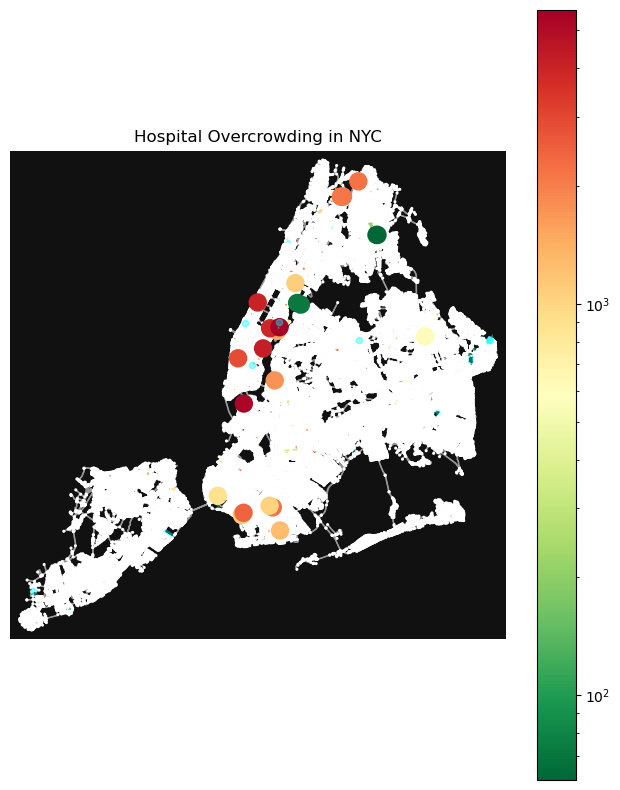

In [267]:
cmap_norm = colors.LogNorm(vmin=density_min, vmax=density_max)


fig, ax = ox.plot_graph(roads_in_manhattan, figsize=(8,10), node_size=5, show=False, close=False)
healthcare_footprints.plot('tract_density',ax=ax, cmap='RdYlGn_r', norm=cmap_norm, markersize=150, legend=True)
healthcare_footprints_no_tract.plot(ax=ax, color='cyan', alpha=0.4, markersize=20)

ax.set_title('Hospital Overcrowding in NYC')

plt.show()

In [268]:
hospitals_density_sort = healthcare_footprints.sort_values(by='tract_density', ascending=False).reset_index()
hospitals_density_sort.head()

,element_type,osmid,geometry,addr:city,addr:housenumber,addr:postcode,addr:street,amenity,beds,emergency,...,name,opening_hours,operator,phone,website,wikidata,wikipedia,tract_pop,tract_area,tract_density
0,node,5421562461,POINT (-73.95269 40.76516),New York,535,10021,East 70th Street,hospital,215,no,...,Hospital for Special Surgery,NaN,NaN,+1 877 606 1555,https://www.hss.edu/,Q5908726,en:Hospital for Special Surgery,10402.0,1.847564,5630.115048
1,node,9885158918,POINT (-73.99422 40.69788),Brooklyn,41,11201,Clark Street,hospital,NaN,NaN,...,Downtown Pain Physicians Of Brooklyn,Su-Fr 08:00-19:00,NaN,+1-718-210-2225,https://www.downtownpainphysicians.com,NaN,NaN,4759.0,0.901507,5278.938312
2,way,278254355,"POLYGON ((-73.98746 40.71329, -73.98724 40.713...",New York,227,10002,Madison Street,hospital,NaN,no,...,Gouverneur Health Medical Center,NaN,NaN,2122387897,NaN,Q5588502,NaN,12554.0,2.582705,4860.794878
3,way,562630644,"POLYGON ((-73.90967 40.84317, -73.90992 40.843...",Bronx,1650,10457,Grand Concourse,hospital,NaN,yes,...,BronxCare Hospital Center,24/7,Bronx-Lebanon Hospital System,+1 718 590 1800,https://www.bronxcare.org/,Q4974154,en:Bronx-Lebanon Hospital Center,1871.0,0.420601,4448.395493
4,node,1581175993,POINT (-73.97179 40.74648),New York,339,10016,East 38th Street,hospital,NaN,no,...,NYU Langone Outpatient Surgery Center,NaN,NYU Langone Health,+1 212 263 1515,https://nyulangone.org/locations/nyu-langone-o...,NaN,NaN,8032.0,1.912110,4200.595380


In [272]:
hospitals_density_sort.loc[0:4,'name'], hospitals_density_sort.loc[0:4,'tract_density']

(0             Hospital for Special Surgery
 1     Downtown Pain Physicians Of Brooklyn
 2         Gouverneur Health Medical Center
 3                BronxCare Hospital Center
 4    NYU Langone Outpatient Surgery Center
 Name: name, dtype: object,
 0    5630.115048
 1    5278.938312
 2    4860.794878
 3    4448.395493
 4    4200.595380
 Name: tract_density, dtype: float64)

In [ ]:
graph_manhattan = ox.io.load_graphml('manhattan_osmnx.graphml')

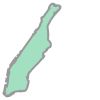

In [263]:
# we can also get a gdf for the footprint of the place
manhattan_footprint = ox.geocode_to_gdf("Manhattan, New York, USA")
manhattan_polygon = manhattan_footprint['geometry'][0]
manhattan_polygon

In [299]:
healthcare_footprints_manhattan = ox.features.features_from_polygon(manhattan_polygon, tags={'amenity':'hospital'}).dropna(subset=['geometry'])
healthcare_footprints_manhattan.to_file("healthcare_footprints.geojson")

In [297]:
manhattan_polygon_gdf = gpd.GeoDataFrame(index=[0], crs='epsg:4326', geometry=[manhattan_polygon])
manhattan_polygon_gdf.to_file("manhattan_polygon.shp")
manhattan_polygon_gdf

,geometry
0,"POLYGON ((-74.01934 40.70608, -74.01931 40.705..."


In [277]:
# merging 
# reading each burrow
bronx_hospitals = pd.read_csv('Bronx_HospitalFootprint.csv')
brooklyn_hospitals = pd.read_csv('Brooklyn_HospitalFootprint.csv')
queens_hospitals = pd.read_csv('queens_hospital.csv')
manhattan_hospitals = pd.read_csv('manhattan_hospitals.csv')
staten_island_hospitals = pd.read_csv('StatenIsland_HospitalFootprint.csv')
all_hospitals = gpd.GeoDataFrame(pd.concat([bronx_hospitals, brooklyn_hospitals, queens_hospitals, manhattan_hospitals, staten_island_hospitals], ignore_index=True))